<p align = "center" draggable=”false” ><img src="https://user-images.githubusercontent.com/37101144/161836199-fdb0219d-0361-4988-bf26-48b0fad160a3.png" 
     width="200px"
     height="auto"/>
</p>

# Hate Speech Detector

Today you are a machine learning engineer, a member of the Birdwatch at Twitter. 

The objective of this task is to detect hate speech in tweets. For the sake of simplicity, a tweet contains hate speech if it has a racist or sexist sentiment associated with it. In other words, we need to classify racist or sexist tweets from other tweets.

A labelled dataset of 31,962 tweets (late 2017 to early 2018) is provided in the form of a compressed csv file with each line storing a tweet id, its label, and the tweet. Label '1' denotes the tweet is racist/sexist while label '0' denotes the tweet is not racist/sexist.

We will first approach the problem in a traditional approach: clean the raw text using simple regex (regular expression), extract features, build a naive Bayes models to classify tweets; then we build a deep learning model and explain our deep learning model with LIME.

## 📚 Learning Objectives

By the end of this lesson, you will be able to:

- Understand the basic concepts in natural language processing (NLP)
- Perform basic NLP tasks on text, e.g., tweets
- Build a naive Bayes classifier to detect hate speech 
- Build a bidirectional long short-term memory (BiLSTM) to detect hate speech
- Visualize embeddings with Tensorboard embedding projector
- Explain models with LIME

# Task I: Data Preprocessing


1. Install dependencies.

    Most modules are pre-installed in Colab, however, we need to update `gensim` to its recent version and install `lime`.

In [127]:
!pip install -U -q gensim==4.2.0 lime

1. Connect Colab to your local Google Drive.

In [128]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


1. Use `pandas.read_csv` to load the tweets in `tweets.csv.gz` and save the `pd.DataFrame` into `raw`. Make sure the path points to where the data is located in your Google Drive. 

In [129]:
# YOUR CODE HERE
import pandas as pd
raw = pd.DataFrame(pd.read_csv('/content/drive/MyDrive/fourthbrain/week-10-natural-language-processing/dat/tweets.csv.gz'))

In [130]:
print(raw.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31962 entries, 0 to 31961
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   id      31962 non-null  int64 
 1   label   31962 non-null  int64 
 2   tweet   31962 non-null  object
dtypes: int64(2), object(1)
memory usage: 749.2+ KB
None


1. Sample 5 random tweets from the dataset for each label and display `label` and `tweet` columns. Hint: one option is to use `sample()` followed by `groupby`. 

In [131]:
# Colab includes an extension that renders pandas dataframes into interactive displays that can be filtered, sorted, and explored dynamically.
from google.colab import data_table
data_table.enable_dataframe_formatter() 

# YOUR CODE HERE
raw.groupby('label').sample(5)[['label', 'tweet']]

,label,tweet
19106,0,iqbal's bihday ððððð be the bes...
1799,0,no broken heas #nomakeup #justeyelashes #beber...
22124,0,"check out this new trending #funny #gif ! , k..."
23793,0,cece and eve are going to have to drag me out ...
5862,0,orange is the new black is back on netflix. th...
25521,1,@user no convo on how to stop indigenous death...
28864,1,@user is this your relation? yeah... that's a ...
17857,1,thought factory: left-right polarisation! #tru...
7043,1,"@user #jcpenny #ranting so, no one, no one, i..."
2695,1,"a #dystopian tale of , #radicalisation &amp; #..."


1. The tweets are in English and all words should be already in lowercase. Now calculate the number of characters in each tweet and assign the values to a new column `len_tweet` in `raw`. 

In [132]:
# YOUR CODE HERE
raw['len_tweet'] = raw['tweet'].str.len()

In [133]:
raw

,id,label,tweet,len_tweet
0,1,0,@user when a father is dysfunctional and is s...,102
1,2,0,@user @user thanks for #lyft credit i can't us...,122
2,3,0,bihday your majesty,21
3,4,0,#model i love u take with u all the time in ...,86
4,5,0,factsguide: society now #motivation,39
...,...,...,...,...
31957,31958,0,ate @user isz that youuu?ðððððð...,68
31958,31959,0,to see nina turner on the airwaves trying to...,131
31959,31960,0,listening to sad songs on a monday morning otw...,63
31960,31961,1,"@user #sikh #temple vandalised in in #calgary,...",67


1. What are the summary statistics of `len_tweet` for each label? Hint: use `groupby` and `describe`. 

In [134]:
pd.set_option("display.precision", 1)

# YOUR CODE HERE

raw.groupby('label')['len_tweet'].describe()

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,29720.0,84.3,29.6,11.0,62.0,88.0,107.0,274.0
1,2242.0,90.2,27.4,12.0,69.0,96.0,111.0,152.0


Note we have an imbalanced dataset: the ratio of non-hate speech to hate speech is roughly 13:1. 

1. Clean the tweets. 

    We use `re` to perform basic text manipulations. Specically, remove anonymized user handle, remove numbers and special characters except hashtags.

In [135]:
import re

1. Remove user handles from the text in `tweet`, or anything directly following the symbols `@`, and save the resulting tweets to a new column `tidy_tweet` in `raw`. 
    
    Hint: you can use `re.sub` on individual text and [`apply`](https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.apply.html) a simple lambda function for the series `raw['tweet']`.

In [136]:
raw['tidy_tweet'] = raw['tweet'].str.replace(r'@([A-Za-z0-9_]+)', '', regex=True) # YOUR CODE HERE
raw.sample(5, random_state=203)

,id,label,tweet,len_tweet,tidy_tweet
790,791,1,@user and you keep telling that only aryans ar...,109,and you keep telling that only aryans are all...
21928,21929,0,@user what makes you ?,25,what makes you ?
25642,25643,0,"â #nzd/usd extends rbnz-led rally, hits fre...",101,"â #nzd/usd extends rbnz-led rally, hits fre..."
20436,20437,0,i'm on a mission to ride all of the animals! ...,91,i'm on a mission to ride all of the animals! ...
22552,22553,0,the color of a human skin matters a lot to the...,88,the color of a human skin matters a lot to the...


1. Remove non-alphabetic characters yet keep symbols `#` from `tidy_tweet` and save the result in `tidy_tweet`. In other words, keep all 26 letters and `#`.

    Note: in some applications, punctuations, emojis, or whether the word is in all caps can be of use. You shall decide whether to extract such features for the application and perform error analysis to gain insight. 

In [137]:
pattern = '[^a-zA-Z#]'
raw['tidy_tweet'] = raw["tidy_tweet"].apply(lambda x: re.sub(pattern, ' ', x)) # YOUR CODE HERE
raw.sample(5, random_state=203)

,id,label,tweet,len_tweet,tidy_tweet
790,791,1,@user and you keep telling that only aryans ar...,109,and you keep telling that only aryans are all...
21928,21929,0,@user what makes you ?,25,what makes you
25642,25643,0,"â #nzd/usd extends rbnz-led rally, hits fre...",101,#nzd usd extends rbnz led rally hits fre...
20436,20437,0,i'm on a mission to ride all of the animals! ...,91,i m on a mission to ride all of the animals ...
22552,22553,0,the color of a human skin matters a lot to the...,88,the color of a human skin matters a lot to the...


1. Remove words that is shorter than 4 words from the processed tweets.

    For example, 
      
    `i m on a mission to ride all of the animals #teamchanlv #vegas #lasvegas #funtimes`
      
    will be reduced to 
      
    `mission ride animals #teamchanlv #vegas #lasvegas #funtimes`


In [138]:
raw['tidy_tweet'] = raw["tidy_tweet"].apply(lambda x: ' '.join([w for w in x.split() if len(w) > 3])) # YOUR CODE HERE
raw.sample(5, random_state=203)

,id,label,tweet,len_tweet,tidy_tweet
790,791,1,@user and you keep telling that only aryans ar...,109,keep telling that only aryans allowed rape wom...
21928,21929,0,@user what makes you ?,25,what makes
25642,25643,0,"â #nzd/usd extends rbnz-led rally, hits fre...",101,#nzd extends rbnz rally hits fresh year high n...
20436,20437,0,i'm on a mission to ride all of the animals! ...,91,mission ride animals #teamchanlv #vegas #lasve...
22552,22553,0,the color of a human skin matters a lot to the...,88,color human skin matters system when comes jud...


1. Remove stop words and text normalization. 
    
    We will use `stopwords` collection and `SnowballStemmer` in `nltk` for this task. Before doing so, we need to tokenize the tweets. Tokens are individual terms or words, and tokenization is simply to split a string of text into tokens. You can use [`str.split()`](https://docs.python.org/3/library/stdtypes.html#str.split) on individual text and [`apply`](https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.apply.html) a simple lambda function for the series `raw['tidy_tweet']` and save the result into `tokenized_tweet`. 
    
    Check out some methods for the built-in type `str` [here](https://docs.python.org/3/library/stdtypes.html#string-methods).

In [139]:
tokenized_tweet = raw['tidy_tweet'].apply(lambda x: x.split()) # YOUR CODE HERE
tokenized_tweet.head()

0    [when, father, dysfunctional, selfish, drags, ...
1    [thanks, #lyft, credit, cause, they, offer, wh...
2                              [bihday, your, majesty]
3                     [#model, love, take, with, time]
4                   [factsguide, society, #motivation]
Name: tidy_tweet, dtype: object

1. Extract stop words and remove them from the tokens.

    Note: depending on the task / industry, it is highly recommended that one curate custom stop words. 

In [140]:
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
stop_words = stopwords.words('english')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [141]:
tokenized_tweet = tokenized_tweet.apply(lambda x: [i for i in x if not i in stop_words]) # YOUR CODE HERE

In [142]:
assert any(word in tokenized_tweet for word in stop_words) == False

1. Create a new instance of a language specific [`SnowballStemmer`](https://www.nltk.org/api/nltk.stem.snowball.html), set the `language` to be "english"; see [how to](https://www.nltk.org/howto/stem.html). 

In [143]:
from nltk.stem.snowball import SnowballStemmer
stemmer = SnowballStemmer('english')# YOUR CODE HERE

In [144]:
tokenized_tweet = tokenized_tweet.apply(lambda x: [stemmer.stem(i) for i in x]) 
tokenized_tweet.head()

0    [father, dysfunct, selfish, drag, kid, dysfunc...
1    [thank, #lyft, credit, caus, offer, wheelchair...
2                                    [bihday, majesti]
3                           [#model, love, take, time]
4                         [factsguid, societi, #motiv]
Name: tidy_tweet, dtype: object

1. Lastly, let's stitch these tokens in `tokenized_tweet` back together and save them in `raw['tidy_tweet']`. Use [`str.join()`](https://docs.python.org/3/library/stdtypes.html#str.join) and `apply`.

In [145]:
raw['tidy_tweet'] = tokenized_tweet.apply(lambda x: ' '.join(x))# YOUR CODE HERE

In [146]:
raw.sample(5)

,id,label,tweet,len_tweet,tidy_tweet
31320,31321,0,omg tears #presumptivenominee @user #weareeq...,117,tear #presumptivenomine #weareequ #womendeliv ...
18238,18239,1,republican trump buddy who's rabid racist can'...,110,republican trump buddi rabid racist figur wron...
26792,26793,0,you may not confuse #successful with ..you ma...,88,confus #success realis thing take #work
24505,24506,0,belated bihday present ð thank you ð #fr...,97,belat bihday present thank #friend #love #pand...
31138,31139,0,to all the kind heas in this world could someo...,139,kind hea world could someon pleas give email p...


# Task 2. Wordcloud and Hashtag

In this task, we want to gain a general idea of what the common words were and how hashtags were used in tweets. We will create wordclouds and extract the top hashtags used in each label. 

1. Before doing so, out of caution of possible data leakage, split the `raw['tidy_tweet']` into training and test datasets in a stratified fashion, set the test size at .25 and random state as 42.
    
    Save the results into `X_train`, `X_test`, `y_train`, and `y_test`.

In [147]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
    raw['tidy_tweet'], raw.label, 
    test_size=0.25, random_state=42, stratify=raw.label)

In [148]:
assert X_train.shape == y_train.shape == (23971, )
assert X_test.shape == y_test.shape == (7991,)

1. A word cloud is a cluster of words depicted in different sizes. The bigger the word appears, the more often it appears in the given text. It can offer an easy visual presentation to reveal the theme of a topic. 

    Function `plot_wordcloud` is provided to plot 50 most frequent words from the given text in the shape of twitter's logo. You may need to replace the image path accordingly.

In [149]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

def plot_wordcloud(text:str) -> None:
    '''
    Plot a wordcloud of top 50 words from the input text
    masked by twitter logo
    '''
    mask = np.array(Image.open('/content/drive/MyDrive/fourthbrain/week-10-natural-language-processing/img/twitter-mask.png')) # REPLACE w/ YOUR FILE PATH
    wordcloud = WordCloud( 
        background_color='white', 
        random_state=42,
        max_words=50, 
        max_font_size=80, 
        mask = mask).generate(text)
    plt.figure(figsize=(10,10))
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.show()

1. Visualize the wordcloud. 

    That the function expects one long string. Stitch all tidy tweets from training set and save the single string to `all_words`, then visualize the wordcloud for all the words.

In [150]:
all_words = ' '.join(raw['tidy_tweet']) # YOUR CODE HERE

In [151]:
all_words

'father dysfunct selfish drag kid dysfunct #run thank #lyft credit caus offer wheelchair van #disapoint #getthank bihday majesti #model love take time factsguid societi #motiv huge fare talk leav chao disput #allshowandnogo camp tomorrow danni next school year year exam think #school #exam #hate #imagin #actorslif #revolutionschool #girl love land #allin #cav #champion #cleveland #clevelandcavali welcom #ireland consum price index climb previous #blog #silver #gold #forex selfish #orlando #standwithorlando #pulseshoot #orlandoshoot #biggerproblem #selfish #heabreak #valu #love daddi today day #gettingf #cnn call #michigan middl school build wall chant #tcot comment #australia #opkillingbay #seashepherd #helpcovedolphin #thecov #helpcovedolphin ouch junior angri #got #junior #yugyoem #omg thank paner #thank #posit retweet agre #friday smile around user #cooki make peopl know essenti oil made chemic #euro peopl blame conced goal rooney gave away free kick know bale littl dude #badday #co

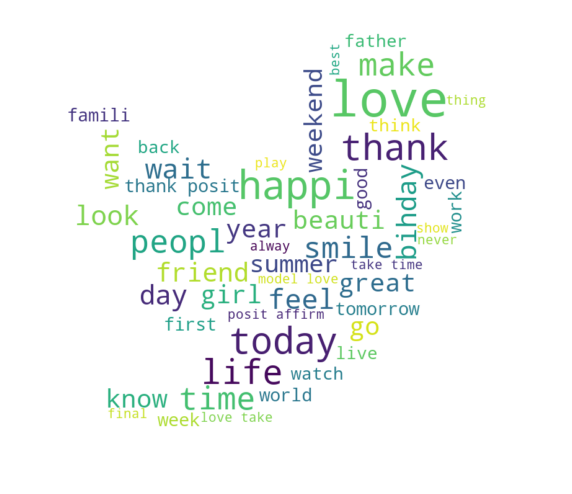

In [152]:
plot_wordcloud(all_words)

1. Visualize the wordcloud just for the text from the tweets identified as hate speech. 

    Similarly, you need to stitch all the tidy tweets in training set that were identified as hate speech. Save the long string to `negative_words`.

In [153]:
negative_words = ' '.join(X_train[y_train == 1]) # YOUR CODE HERE
negative_words

'fuck fuck bitch real simpleton figur pmet youth parliament #democraci listen free prop #jesus #black white promot #hate #biggotri need call vile scum fed provid inadequ #mentalhealth care #firstnat intern memo #thirdworldcanada #mmusimaiman toward white #zuma #malema combin #southafrica stand racism hate americad curs congress hater deplor #hate would best thing done #gop #con vote #nazi #fascist #dictat #trump scare littl bulli disgust #grandmoth #grandson #exist #alreadi trump #fascist #bigot #misogynist #sexualpred proven word much hatr toward jew xian rememb xian kenya nigeria #fuckdonaldtrump thdocumentari bitch #presid anti racist white murder black south africa #whitegenocid #southafrica stupid discredit white privileg dummi texa allow choke kid #msnbc latest thank #culturesway john terri chose white christma favourit christma song surpris door sorri mofo #youdisgustm #kickrock come back white dumbass heard #ris clip quot tweet prop expos view challeng latest cogniz blogger tha

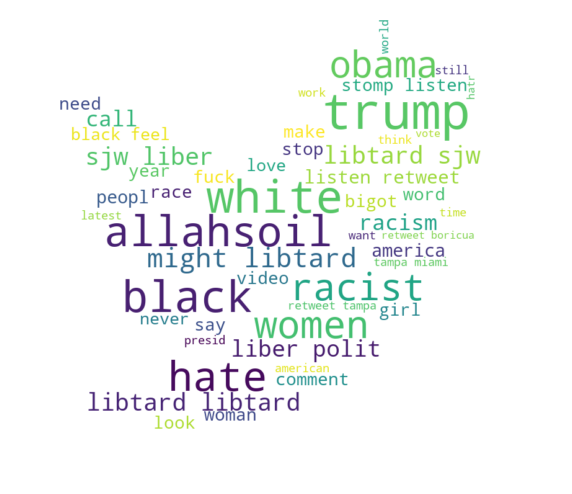

In [154]:
plot_wordcloud(negative_words)

1. Hashtag is a feature for tweets and we would like to inspect if hashtags provide information for our classification task. 

    Function `hashtag_extract` is provided to extract hashtags from an iterable (list or series) and return the hashtags in a list. 

In [155]:
def hashtag_extract(x) -> list:
    """
    extract hastags from an iterable (list or series) and 
    return the hashtags in a list.
    """
    hashtags = []
    # Loop over the words in the tweet
    for i in x:
        ht = re.findall(r"#(\w+)", i)
        hashtags.append(ht)
    return hashtags

1. Extract hashtags from non-hate speech tweets.

In [156]:
HT_regular = hashtag_extract(X_train[y_train == 0]) # YOUR CODE HERE

In [157]:
assert type(HT_regular) == list
assert type(HT_regular[0]) == list # nested list

1. Now extract hashtags from hate speech tweets.

In [158]:
HT_negative = hashtag_extract(X_train[y_train == 1]) # YOUR CODE HERE

1. Both `HT_regular` and `HT_negative` are nested lists, use the following trick to un-nest both lists.

In [159]:
HT_regular = sum(HT_regular,[])
HT_negative = sum(HT_negative,[])

In [160]:
assert type(HT_regular) == type(HT_negative) == list
assert type(HT_regular[0]) == type(HT_negative[0]) == str

1. Complete the function `top_hashtags` that takes a list of hashtags and return the top `n` hashtag keyword and its frequency. 

In [161]:
from typing import List, Tuple
from collections import Counter
def top_hashtags(hashtags:List[str], n=10) -> List[Tuple[str, int]]:
    ''' Function to return the top n hashtags '''
    # YOUR CODE HERE
    mydict = Counter(hashtags)
    # return [ht for ht, count in mydict.most_common(n)]
    return mydict.most_common(n)

1. Apply the function to the hashtag lists from the non-hate speech tweets and the hate speech tweets.

In [162]:
# YOUR CODE HERE
top_hashtags(HT_regular)

[('love', 1245),
 ('posit', 693),
 ('smile', 514),
 ('healthi', 423),
 ('thank', 398),
 ('fun', 345),
 ('life', 329),
 ('affirm', 324),
 ('summer', 291),
 ('model', 284)]

In [163]:
# YOUR CODE HERE
top_hashtags(HT_negative)

[('trump', 97),
 ('allahsoil', 77),
 ('polit', 73),
 ('liber', 62),
 ('libtard', 57),
 ('sjw', 56),
 ('retweet', 50),
 ('miami', 37),
 ('black', 36),
 ('hate', 28)]

1. Discuss: are these hashtags making sense? should we include them as features or should we strip the # before tokenizing (that is, treat "#love" the same as "love")? why and why not?

          YOUR ANSWER HERE
          The hashtags make sense, and are reflective of positive and negative words. 
          Hashtags represent intended intention and helpful in recognizing complex 
          sentences like saracasm, and might be candidate for more weightage. 
          Stripping the hashtags would make the hashtags equivalent to rest of the tweet body.


# Task 3. Features

Note that almost all the machine learning related Python modules expects numerical presentation of data; thus we need to transform our text first.We will experiment bag of words, tf-idf, and word2vec.  

1. Convert the collection of text documents to a matrix of token counts.

    Check the [official documentation](https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.CountVectorizer.html). 
    
    Create an instance of `CountVectorizer` named `bow_vectorizer`, set `max_features` to be `MAX_FEATURES`.
    Learn the vocabulary dictionary and return document-term matrix and save it to `bow_train`. Use `.fit_transform`. 

In [164]:
from sklearn.feature_extraction.text import CountVectorizer
MAX_FEATURES = 1000


bow_vectorizer = CountVectorizer(max_features=MAX_FEATURES)# YOUR CODE HERE
bow_train = bow_vectorizer.fit_transform(X_train) # YOUR CODE HERE

In [165]:
assert bow_train.shape == (X_train.shape[0], MAX_FEATURES)

1. Print the first three rows from `bow_train`. Hint: `.toarray()`.

In [166]:
# YOUR CODE HERE
bow_train[:3,:].toarray()
# bow_train[:3,:].shape

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [167]:
from scipy.sparse.csr import csr_matrix
assert type(bow_train) == csr_matrix

1. Similarly, convert the collection of text documents to a matrix of TF-IDF features.
    
    Create an instance of [`TfidfVectorizer`](https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.TfidfVectorizer.html#sklearn.feature_extraction.text.TfidfVectorizer) named `tfidf_vectorizer`, set `max_features` to be `MAX_FEATURES`.

    Learn the vocabulary and idf, return document-term matrix and save it to `tfidf_train`. 

In [168]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [169]:
tfidf_vectorizer = TfidfVectorizer(max_features=MAX_FEATURES, stop_words='english')  # YOUR CODE HERE
tfidf_train = tfidf_vectorizer.fit_transform(X_train)

In [170]:
assert type(tfidf_train) == csr_matrix
assert tfidf_train.shape == bow_train.shape == (X_train.shape[0], MAX_FEATURES)

1. Extract word embedding using Word2Vec. We will use [`gensim`](https://radimrehurek.com/gensim/auto_examples/tutorials/run_word2vec.html) for this task. 
    
    The Word2Vec model takes either a list of lists of tokens or an iterable that streams the sentences directly from disk/network. Here, we tokenize the tidy tweets in `X_train` and save the list (`pd.series`) of lists of tokens to `tokenized_tweet`. 

In [171]:
X_train.shape

(23971,)

In [172]:
tokenized_tweet = pd.Series([line.split(' ') for line in X_train]) # YOUR CODE HERE

In [173]:
tokenized_tweet.shape

(23971,)

In [174]:
assert tokenized_tweet.shape == X_train.shape

In [175]:
tokenized_tweet.head()

0    [like, spread, peanut, butter, white, bread, #...
1    [watch, made, america, simpson, interest, went...
2    [franci, underwood, seen, leav, marseill, #nojok]
3    [#enjoy, #music, #today, #free, #app, #free, #...
4    [#juic, experi, #notsobad, #healthyliv, #eatcl...
dtype: object

1. Import `Word2Vec` from `gensim.models`; see [doc](https://radimrehurek.com/gensim/models/word2vec.html#gensim.models.word2vec.Word2Vec). 

    Create a skip-gram `Word2Vec` instance named `w2v` that learns on the `tokenized_tweet`, with `vector_size` set at `MAX_FEATURES`, and other parameters are provided. 

In [176]:
from gensim.models import Word2Vec

In [177]:
w2v = Word2Vec(
        tokenized_tweet, # YOUR CODE HERE
        vector_size = MAX_FEATURES, # YOUR CODE HERE
        window=5, min_count=2, sg = 1, 
        hs = 0, negative = 10,  workers= 2, 
        seed = 34)

In [178]:
w2v.corpus_count

23971

1. Train the skip-gram model, set the epochs at 20.

In [179]:
%%time
# YOUR CODE HERE
w2v.train(tokenized_tweet, total_examples=w2v.corpus_count, epochs=20)

CPU times: user 1min 32s, sys: 136 ms, total: 1min 32s
Wall time: 50.4 s


(2738387, 3223400)

1. Let's see how the model performs. Specify a word (e.g., 'dinner' or 'trump') and print out the 10 most similar words from the our tweets in the training set. Use [`most_similar`](https://radimrehurek.com/gensim/models/keyedvectors.html#gensim.models.keyedvectors.KeyedVectors.most_similar). Hint: print the type of `w2v` and `w2v.wv`.

In [180]:
# YOUR CODE HERE
# type(w2v.wv)
w2v.wv.most_similar('trump')

[('donald', 0.6125057339668274),
 ('croni', 0.570662260055542),
 ('unfit', 0.5670210123062134),
 ('unstabl', 0.5667680501937866),
 ('berni', 0.5656055212020874),
 ('overwhelm', 0.5652537941932678),
 ('#unpresid', 0.5623044967651367),
 ('teleprompt', 0.5506057143211365),
 ('commi', 0.5503803491592407),
 ('associ', 0.5498021245002747)]

1. Discuss: how does it calculate the similarities? 

    YOUR ANSWER HERE
    Decent but not really well! The model considers Trump roughly 54% #unprecedential - and that was a deal breaker for me :) On a series note, Donald and Trump often occurs together, and the confidence of 60% being related is not great!

1. Discuss: do you think Word2Vec is supervised or unsupervised?

    YOUR ANSWER HERE: It is supervised in the sense that it is being trained on some data. It is unsupervised because the data has no lables. I would consider it semi-supervised.

1. Engineer features. 

    For each tweet, we calculate the average of embeddings (function `word_vector`) and then apply it to every tidy tweet in `X_train` (use function `tokens_to_array`).
    Both functions are provided, inspect the code and save the features in `w2v_train`.

In [181]:
from gensim.models.keyedvectors import KeyedVectors

def word_vector(tokens:list, size:int, keyed_vec:KeyedVectors= w2v.wv):
    vec = np.zeros(size).reshape((1, size))
    count = 0
    for word in tokens:
        try:
            vec += keyed_vec[word].reshape((1, size))
            count += 1
        except KeyError: 
            # handling the case where the token is not in vocabulary        
            continue
    if count != 0:
        vec /= count
    return vec

def tokens_to_array(tokens:list, size:int, keyed_vec:KeyedVectors= w2v.wv):
    array = np.zeros((len(tokens), size))
    for i in range(len(tokens)):
        array[i,:] = word_vector(tokens.iloc[i], size, keyed_vec=keyed_vec)
    return array

In [182]:
w2v_train = tokens_to_array(tokenized_tweet, size=MAX_FEATURES) # YOUR CODE HERE

In [183]:
assert w2v_train.shape == (X_train.shape[0], MAX_FEATURES)

1. Prepare the test data before modeling for each approach:


  - extract features from `X_test` using the bag of words approach; use `bow_vectorizer`
  - extract features from `X_test` using the tf-idf approach; use `tfidf_vectorizer`
  - extract features from `X_test` using Word2Vec embeddings; you need to first tokenized the tidy tweets in `X_test`, then convert the tokens to array of shape `(X_test.shape[0], MAX_FEATURES)`.

In [184]:
bow_test = bow_vectorizer.transform(X_test)# YOUR CODE HERE
tfidf_test = tfidf_vectorizer.transform(X_test)# YOUR CODE HERE

tokenized_tweet_test = X_test.apply(lambda x: x.split())# YOUR CODE HERE
w2v_test = tokens_to_array(tokenized_tweet_test, size=MAX_FEATURES) # YOUR CODE HERE

In [185]:
assert bow_test.shape == tfidf_test.shape == w2v_test.shape == (X_test.shape[0], MAX_FEATURES)

# Task 4. Naive Bayes classifiers

In this task, you will build a [naive Bayes](https://sebastianraschka.com/Articles/2014_naive_bayes_1.html) (here's another [ref](https://www.inf.ed.ac.uk/teaching/courses/inf2b/learnnotes/inf2b-learn07-notes-nup.pdf)), classifiers to identify the hate speech tweets using different sets of features from the last task, and evaluate their performances. 

In the era of deep learning, naive Bayes is useful due to its simplicity and reasonable performance, especially if there is not much training data available. A common interview question is "Why is naive Bayes naive?". 

We will use multi-variate Bernoulli naive Bayes [`BernoulliNB`](https://scikit-learn.org/stable/modules/generated/sklearn.naive_bayes.BernoulliNB.html); try other flavors of [naive Bayes](https://scikit-learn.org/stable/modules/classes.html#module-sklearn.naive_bayes) if time permits. Code is pretty straightforward. 

1. Import `BernoulliNB` for modeling and `classification_report` for reporting performance. 

In [195]:
from sklearn.naive_bayes import BernoulliNB
from sklearn.metrics import classification_report

1. Create an instance of  `BernoulliNB` named `BNBmodel`. 

    We can use it for all three feature sets.

In [196]:
# YOUR CODE HERE
BNBmodel = BernoulliNB()

1. Train the multi-variate Bernoilli naive Bayes using bag of words features and print the performance report.

In [197]:
# YOUR CODE HERE (train the model)
BNBmodel.fit(bow_train, y_train)

BernoulliNB()

In [199]:
# YOUR CODE HERE (report)
bow_pred_test = BNBmodel.predict(bow_test)
print(classification_report(y_test, bow_pred_test))

              precision    recall  f1-score   support

           0       0.96      0.97      0.97      7430
           1       0.56      0.46      0.51       561

    accuracy                           0.94      7991
   macro avg       0.76      0.72      0.74      7991
weighted avg       0.93      0.94      0.93      7991



1. Similarly, train the model using tf-idf features and print the performance report. 

    Is the performance expected? Why or why not?


In [200]:
# YOUR CODE HERE
BNBmodel.fit(tfidf_train, y_train)

BernoulliNB()

In [201]:
# YOUR CODE HERE
tfidf_pred_test = BNBmodel.predict(tfidf_test)
print(classification_report(y_test, tfidf_pred_test))

              precision    recall  f1-score   support

           0       0.96      0.97      0.97      7430
           1       0.56      0.47      0.51       561

    accuracy                           0.94      7991
   macro avg       0.76      0.72      0.74      7991
weighted avg       0.93      0.94      0.93      7991



ANS: The performance is almost similar in both the BOW and tf-idf methods. It is expected as the date has been pre-processed, which removes some advantage tf-idf may have had over BOW. The poor performace on positive class is reflective of the data imbalance.

1. Finally, train the model using Word2Vec embeddings and report the performance. 

In [202]:
# YOUR CODE HERE
BNBmodel.fit(w2v_train, y_train)
# YOUR CODE HERE
w2v_pred_test = BNBmodel.predict(w2v_test)
print(classification_report(y_test, w2v_pred_test))

              precision    recall  f1-score   support

           0       0.98      0.85      0.91      7430
           1       0.29      0.82      0.43       561

    accuracy                           0.85      7991
   macro avg       0.64      0.83      0.67      7991
weighted avg       0.94      0.85      0.88      7991



1. Discuss the differences in performance using tf-idf vs skim-gram embedding. 

    YOUR ANSWER HERE

    The performance of skip-gram seem to be worse than tf-idf except for recall on positive class, likely due to data imbalance.

1. Examine a few tweets where the model(s) failed. What other features would you include in the next iteration?

    YOUR ANSWER HERE
    The model is failing to capture contextual information e.g. Second tweet below is a tweet compalining about posting negative stuff but is tagged as racist. Similarly, tweet 5693 is tagged non-racist despite using inflamatory language.

In [230]:
misclassified_tfidf = np.where(np.array(y_test) != tfidf_pred_test)
misclassified_index = X_test.iloc[misclassified_tfidf].index
raw.iloc[misclassified_index]

,id,label,tweet,len_tweet,tidy_tweet
31522,31523,0,@user it's sad!! our world is turning into a ...,126,world turn polit zoolog disast govern truli ev...
23135,23136,1,@user why is #obamalegacy only showing negativ...,103,#obamalegaci show negat stuff confus #obama #p...
15634,15635,1,@user this guy look like his brother is @user ...,128,look like brother first wife found anoth document
25629,25630,1,you me too ððððð ð¹,36,
5693,5694,0,maybe it's time for conservatives &amp; workin...,88,mayb time conserv work class american realli t...
...,...,...,...,...,...
7556,7557,1,who had that 4 #blackpeople beat up a #whitep...,131,#blackpeopl beat #whiteperson might make aliv ...
4435,4436,1,@user who the hell is juan to decide if kellya...,124,hell juan decid kellyann rais kid work year stand
16173,16174,1,@user @user if i cud this 1000x i wud. #black...,106,#blackonblack #ris #antiblack #dogwhistl #blac...
9284,9285,0,until the usa gets it's gun laws under control...,132,get law control noth chang last peopl listen g...


# Task 5. Bidirectional LSTM 

In this task, you will build a bidirectional LSTM (BiLSTM) model to detect tweets identified as hate speech, and visualize the embedding layer using Tensorboard projector. 

Why BiLSTM? LSTM, at its core, preserves information from inputs that has already passed through it using the hidden state. Unidirectional LSTM only preserves information of the past because the only inputs it has seen are from the past. BiLSTMs run inputs in both ways, one from past to future and one from future to past and show very good results as they can understand context better [ref](https://stackoverflow.com/questions/43035827/whats-the-difference-between-a-bidirectional-lstm-and-an-lstm).

1. Tokenizing and padding. 
    
    As LSTM expects every sentence to be of the same length, in addition to [`Tokenizer`](https://www.tensorflow.org/api_docs/python/tf/keras/preprocessing/text/Tokenizer) with a given number of vocabulary `VOCAB_SIZE`, we need to [pad](https://www.tensorflow.org/api_docs/python/tf/keras/utils/pad_sequences) shorter tweets with 0s until the length is `MAX_LEN` and truncate longer tweets to be exact `MAX_LEN` long. 
    
   Function `tokenize_pad_sequences` is provided except that you need to supply correct `num_words` and `filters`; do NOT filter `#`. 
   
   We feed the processed `tidy_tweet` to `tokenize_pad_sequences`, but one can perform the preprocessing steps in `Tokenizer` and apply it directly on the raw tweets.

In [231]:
VOCAB_SIZE = 25000  
MAX_LEN = 50

In [237]:
import tensorflow as tf
from tensorflow import keras

from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences

def tokenize_pad_sequences(text):
    '''
    tokenize the input text into sequences of integers and then
    pad each sequence to the same length
    '''
    # Text tokenization
    tokenizer = Tokenizer(
        num_words = VOCAB_SIZE, # YOUR CODE HERE
        filters = pattern, # YOUR CODE HERE
        lower=True, split=' ', oov_token='oov')
    tokenizer.fit_on_texts(text)
    # Transforms text to a sequence of integers
    X = tokenizer.texts_to_sequences(text)
    # Pad sequences to the same length
    X = pad_sequences(X, padding='post', maxlen=MAX_LEN)

    return X, tokenizer

In [238]:
print('Before Tokenization & Padding \n', raw['tidy_tweet'][0])
X, tokenizer = tokenize_pad_sequences(raw['tidy_tweet'])
print('After Tokenization & Padding \n', X[0])
y = raw['label'].values

Before Tokenization & Padding 
 father dysfunct selfish drag kid dysfunct #run
After Tokenization & Padding 
 [   9   34 4518 1809  229   19  185 4518  330    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0]


1. Let's split `X` into training and testing datasets, save 25% for testing. Then split training dataset into training and validation datasets, with 20% for validation. Set both `random_state` to be 42. Both splits shall be done by stratification.

In [239]:
X_train, X_test, y_train, y_test = train_test_split(
    # YOUR CODE HERE
    X, y, test_size=0.25, random_state=42, stratify=y
    )
X_train, X_val, y_train, y_val = train_test_split(
    # YOUR CODE HERE
    X_train, y_train, test_size=0.2, random_state=42, stratify=y_train
    )

In [240]:
print('Train Set ->', X_train.shape, y_train.shape)
print('Validation Set ->', X_val.shape, y_val.shape)
print('Test Set ->', X_test.shape, y_test.shape)

Train Set -> (19176, 50) (19176,)
Validation Set -> (4795, 50) (4795,)
Test Set -> (7991, 50) (7991,)


1. Now build a sequential model:

    - an embedding layer
    - a bidirectional LSTM with 32 units and set `return_sequences=True` in LSTM
    - a global average pooling operation for temporal data
    - a dropout layer with 20% rate
    - a dense layer of 32 units and set the activation function to be ReLu
    - a dense layer of 1 unit and set the proper activation function for classification

In [242]:
from keras.models import Sequential
# YOUR CODE HERE (layer imports)
from keras.layers import Embedding, Bidirectional, LSTM, GlobalAveragePooling1D, Dropout, Dense

EMBEDDING_DIM = 16   
model = Sequential([
    # YOUR CODE HERE
    Embedding(input_dim=VOCAB_SIZE, output_dim=EMBEDDING_DIM),
    Bidirectional(LSTM(32, return_sequences=True)),
    GlobalAveragePooling1D(),
    Dropout(0.2),
    Dense(32, activation='relu'),
    Dense(1, activation='sigmoid')
])


In [243]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, None, 16)          400000    
                                                                 
 bidirectional (Bidirectiona  (None, None, 64)         12544     
 l)                                                              
                                                                 
 global_average_pooling1d (G  (None, 64)               0         
 lobalAveragePooling1D)                                          
                                                                 
 dropout (Dropout)           (None, 64)                0         
                                                                 
 dense (Dense)               (None, 32)                2080      
                                                                 
 dense_1 (Dense)             (None, 1)                 3

1. Compile the model. 

    Fill in a proper loss function and use adam as the optimizer. For metrics, include precision and recall in the metrics, in addition to accuracy. 

In [257]:
from keras.metrics import Precision, Recall, Accuracy
model.compile(
    loss=keras.losses.BinaryCrossentropy(),# YOUR CODE HERE
    optimizer='adam', 
    metrics= ['accuracy', keras.metrics.Precision(), keras.metrics.Recall()]# YOUR CODE HERE]
    ) 

1. Train the model for 10 epochs on training dataset with a  validation set.

In [258]:
EPOCHS=10
BATCH_SIZE = 32
history = model.fit(X_train, y_train,
                    validation_data=(X_val, y_val), # YOUR CODE HERE
                    batch_size=BATCH_SIZE, epochs=EPOCHS, verbose=2)

Epoch 1/10
600/600 - 10s - loss: 0.0103 - accuracy: 0.9973 - precision_1: 0.9807 - recall_1: 0.9814 - val_loss: 0.2598 - val_accuracy: 0.9493 - val_precision_1: 0.6458 - val_recall_1: 0.6131 - 10s/epoch - 17ms/step
Epoch 2/10
600/600 - 6s - loss: 0.0089 - accuracy: 0.9977 - precision_1: 0.9880 - recall_1: 0.9792 - val_loss: 0.3021 - val_accuracy: 0.9481 - val_precision_1: 0.6283 - val_recall_1: 0.6339 - 6s/epoch - 10ms/step
Epoch 3/10
600/600 - 6s - loss: 0.0063 - accuracy: 0.9984 - precision_1: 0.9903 - recall_1: 0.9866 - val_loss: 0.3081 - val_accuracy: 0.9493 - val_precision_1: 0.6587 - val_recall_1: 0.5744 - 6s/epoch - 10ms/step
Epoch 4/10
600/600 - 6s - loss: 0.0059 - accuracy: 0.9985 - precision_1: 0.9933 - recall_1: 0.9859 - val_loss: 0.3960 - val_accuracy: 0.9445 - val_precision_1: 0.6074 - val_recall_1: 0.5893 - 6s/epoch - 10ms/step
Epoch 5/10
600/600 - 7s - loss: 0.0079 - accuracy: 0.9984 - precision_1: 0.9932 - recall_1: 0.9844 - val_loss: 0.2963 - val_accuracy: 0.9472 - val

1. Function `plot_graphs` is provided below to visualize how the performance of model progresses as a function of epoch. 

    Visualize accuracy and loss. 

In [259]:
def plot_graphs(history, metric):
  fig, ax = plt.subplots()
  plt.plot(history.history[metric])
  plt.plot(history.history['val_'+metric], '')
  ax.set_xticks(range(EPOCHS))
  plt.xlabel("Epochs")
  plt.ylabel(metric)
  plt.legend([metric, 'val_'+metric])

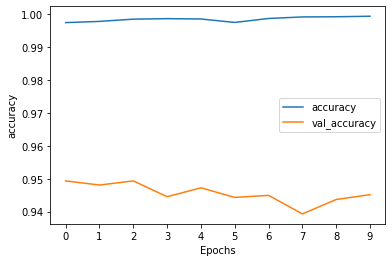

In [261]:
# YOUR CODE HERE
plot_graphs(history, 'accuracy')

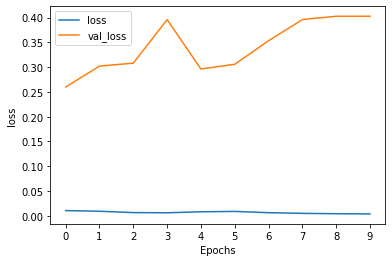

In [262]:
# YOUR CODE HERE
plot_graphs(history, 'loss')

1. The model starts to overfit in a couple of epochs. Consider using [early stopping](https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping) to stop training when a monitored metric has stopped improving. 

    What can we do to tame overfitting?

        YOUR ANSWER HERE

        General overfitting fix techniques include regularization, data augmentation, early stopping and less complex model.

1. Print the classification report of the model on test dataset. 

In [264]:
# YOUR CODE HERE
from sklearn.metrics import confusion_matrix
print(classification_report(y_test, np.round(model.predict(X_test))))

              precision    recall  f1-score   support

           0       0.97      0.97      0.97      7430
           1       0.57      0.61      0.59       561

    accuracy                           0.94      7991
   macro avg       0.77      0.79      0.78      7991
weighted avg       0.94      0.94      0.94      7991



1. Discuss: how does the BiLSTM model improve the classification over naive Bayes? 

    YOUR ANSWER HERE

    The BiLSTM model is performing better than naive Bayes, except in the case of minority class recall.

In [265]:
# # NB using tf-idf
#               precision    recall  f1-score   support

#            0       0.96      0.97      0.97      7430
#            1       0.55      0.48      0.51       561

#     accuracy                           0.94      7991
#    macro avg       0.75      0.72      0.74      7991
# weighted avg       0.93      0.94      0.93      7991

# # NB using word2vec
#               precision    recall  f1-score   support

#            0       0.98      0.85      0.91      7430
#            1       0.29      0.82      0.43       561

#     accuracy                           0.85      7991
#    macro avg       0.64      0.83      0.67      7991
# weighted avg       0.94      0.85      0.88      7991

1. Visualize embedding using [Embedding Projector](https://www.tensorflow.org/tensorboard/tensorboard_projector_plugin) in Tensorboard. The setup for Tensorboard can be tricky, most of the code is provided. 

    TensorBoard reads tensors and metadata from the logs of your tensorflow projects. The path to the log directory is specified with log_dir below. 
    
    In order to load the data into Tensorboard, we need to save a training checkpoint to that directory, along with metadata that allows for visualization of a specific layer of interest in the model.

    Load the TensorBoard notebook extension and import `projector` from `tensorboard.plugins`.

In [277]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [278]:
from tensorboard.plugins import projector

1. Clear any logs from previous runs if any

In [279]:
rm -rf /logs/  

1. Set up a logs directory, so Tensorboard knows where to look for data.

In [280]:
import os
log_dir='/logs/tweets-example/'
if not os.path.exists(log_dir):
    os.makedirs(log_dir)

1. Save the first `VOCAB_SIZE` most frequent words in the vocabulary as `metadata.tsv`.

In [281]:
with open(os.path.join(log_dir, 'metadata.tsv'), "w") as f:
  i = 0
  for label in tokenizer.word_index.keys():
    if label == 'oov':
      continue # skip oov
    f.write("{}\n".format(label))
    if i > VOCAB_SIZE:
      break
    i += 1

1. Save the weights we want to analyze as a variable. Note that the first value represents any unknown word, which is not in the metadata, here we will remove this value.

In [282]:
weights = tf.Variable(model.layers[0].get_weights()[0][1:]) # `embeddings` has a shape of (num_vocab, embedding_dim) 

1. Create a checkpoint from embedding, the filename and key are the name of the tensor.

In [283]:
checkpoint = tf.train.Checkpoint(embedding=weights)
checkpoint.save(os.path.join(log_dir, "embedding.ckpt"))

'/logs/tweets-example/embedding.ckpt-1'

1. Set up config.

In [284]:
config = projector.ProjectorConfig()
embedding = config.embeddings.add()

1. The name of the tensor will be suffixed by `/.ATTRIBUTES/VARIABLE_VALUE`.

In [285]:
embedding.tensor_name = "embedding/.ATTRIBUTES/VARIABLE_VALUE"
embedding.metadata_path = 'metadata.tsv'
projector.visualize_embeddings(log_dir, config)

1. Verify the following files exist under the current directory

In [286]:
ls /logs/tweets-example/

checkpoint                            metadata.tsv
embedding.ckpt-1.data-00000-of-00001  projector_config.pbtxt
embedding.ckpt-1.index


1. Now run Tensorboard against on log data we just saved. 

    You may need to run this cell **twice** to see the projector correctly. Use Chrome for least friction.

In [287]:
%tensorboard --logdir /logs/tweets-example/

Reusing TensorBoard on port 6006 (pid 3615), started 0:02:04 ago. (Use '!kill 3615' to kill it.)

<IPython.core.display.Javascript object>

The TensorBoard Projector can be a great tool for interpreting and visualzing embedding. The dashboard allows users to search for specific terms, and highlights words that are adjacent to each other in the embedding (low-dimensional) space. Try a few word in the Search box and see if the embeddings make sense. 

# Task 6. Interpretation

Lastly let's try to understnad predictions by BiLSTM using a model agnostic approach -- [Local interpretable model-agnostic explanations (LIME)](https://christophm.github.io/interpretable-ml-book/lime.html)

1. Import `LimeTextExplainer` from the [`lime_text`](https://lime-ml.readthedocs.io/en/latest/lime.html#module-lime.lime_text) module in package [`lime`](https://github.com/marcotcr/lime)

In [288]:
from lime.lime_text import LimeTextExplainer

1. Create an instance of `LimeTextExplainer`, call it `explanier`. 

In [289]:
explainer = LimeTextExplainer(class_names=['no', 'yes'], random_state=2)

1. Method `explain_instance` expects the `classifier_fn` to be a function, we provide the function `predict_proba` as below. 

In [290]:
def predict_proba(arr):
    processed = tokenizer.texts_to_sequences(arr)
    processed = pad_sequences(processed, padding='post', maxlen=MAX_LEN)
    pred = model.predict(processed)
    r = []
    for i in pred:
        temp = i[0]
        r.append(np.array([1-temp,temp])) 
    return np.array(r)

1. Read about [`explain_instance`](https://lime-ml.readthedocs.io/en/latest/lime.html#lime.lime_text.LimeTextExplainer.explain_instance). 

    Create an instance named `exp` to explain the 16399th tidy tweet from the original dataset, i.e., `raw.tidy_tweet.iloc[16399]`. 

In [294]:
def explain(id):
  return explainer.explain_instance(
    # YOUR CODE HERE
    raw.tidy_tweet.iloc[id],
    classifier_fn=predict_proba,
    num_features=6)
idx = 16399 
exp = explain(idx)
exp.show_in_notebook(text=raw.tidy_tweet.iloc[idx])

1. Pick another random tweet and generate explanations for the prediction.

In [295]:
# YOUR CODE HERE
idx = 13544
exp = explain(idx)
exp.show_in_notebook(text=raw.tidy_tweet.iloc[idx])

1. Jot down your observations in explaining the model. 

    YOUR ANSWER HERE

    The model seems to be focussing on specific words.

# Acknowledgement & Reference

- Data is adapted from [Twitter sentiment analysis](https://datahack.analyticsvidhya.com/contest/practice-problem-twitter-sentiment-analysis/#ProblemStatement)
- [Twitter sentiment analysis](https://github.com/prateekjoshi565/twitter_sentiment_analysis/blob/master/code_sentiment_analysis.ipynb) 
- [Introduction to Word Embedding and Word2Vec](https://towardsdatascience.com/introduction-to-word-embedding-and-word2vec-652d0c2060fa)
- [When to use GRU over LSTM?](https://datascience.stackexchange.com/questions/14581/when-to-use-gru-over-lstm)
- Use a trained Word2Vec, Doc2Vec or FastTest embedding by `gensim` in buiding an embedding layers in Tensorflow, here's [how-to](https://github.com/RaRe-Technologies/gensim/wiki/Using-Gensim-Embeddings-with-Keras-and-Tensorflow).

# Additonal Questions

## Algorithm Understanding
**How does the Naive Bayes Classifier work?
What is Posterior Probability?**

Naive Bayes classifier is a classification algorithm that is based on Bayes' theoram. It is called Naive because of assumption of independence among variables - which is seldom the case. 

Bayes' theoram is given by P(A|B) = (P(B|A) * P(A))/ P(B)

Here P(A|B) is called Posterior Probability, which is a conditional probability of A (target) given prior probability knowledge of B (attributes).

The steps involved are:

1. Convert data into frequency table
2. Convert likelyhood table by finding probabilities
3. Use naive bayes to find posterior probability for each class. The class with highest posterior probability is the outcome of prediction.

The class with the highest posterior probability is the outcome of prediction.

## What is the difference between stemming and lemmatization in NLP?

Stemming and lemmatization both reduce words to common base forms. 

The difference is stemming achieves this goals by remove common suffixes, crudely returning stem words. Lemmatization does things in a more morphological way and returns the dictionary form of words called lemma.

Stemming tends to be a faster process, vs lemmatization will be slower.

## What is Word2Vec and how does it work?
Word2vec is a techniqie for converting words into multidimensional vectors using word embeddings. These words vectors can be in hundreds of dimensions and are positioned in vector space such that common context in corpus are located close to each other.

Given a large enough dataset, Word2Vec can make strong estimates about a word’s meaning based on their occurrences in the text. These estimates yield word associations with other words in the corpus.

## Interview Readiness
**When to use GRU over LSTM?**

LSTM ’s and GRU’s is created as the solution to short-term memory. They have internal mechanisms called gates that can regulate the flow of information.

GRU use less training parameters and therefore use less memory, execute faster and train faster than LSTM's whereas LSTM is more accurate on dataset using longer sequence. So GRU is prefereable when less memory consumption and faster operation are required for a task over LSTM.